In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import glob
import seaborn as sns
import folium
import numpy as np
import matplotlib.colors as mcolors

%matplotlib inline

In [5]:
# Load the shapefiles
gdf1 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt30*.shp")[0])
gdf2 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt50*.shp")[0])
gdf3 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt75*.shp")[0])
gdf4 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt100*.shp")[0])
gdf5 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt150*.shp")[0])
gdf6 = gpd.read_file(glob.glob("/mnt/Ddrive/projects/superparcels/outputs/55107/*dt200*.shp")[0])

In [ ]:
display(gdf1.shape)
display(gdf2.shape)
display(gdf3.shape)
display(gdf4.shape)
display(gdf5.shape)
display(gdf6.shape)

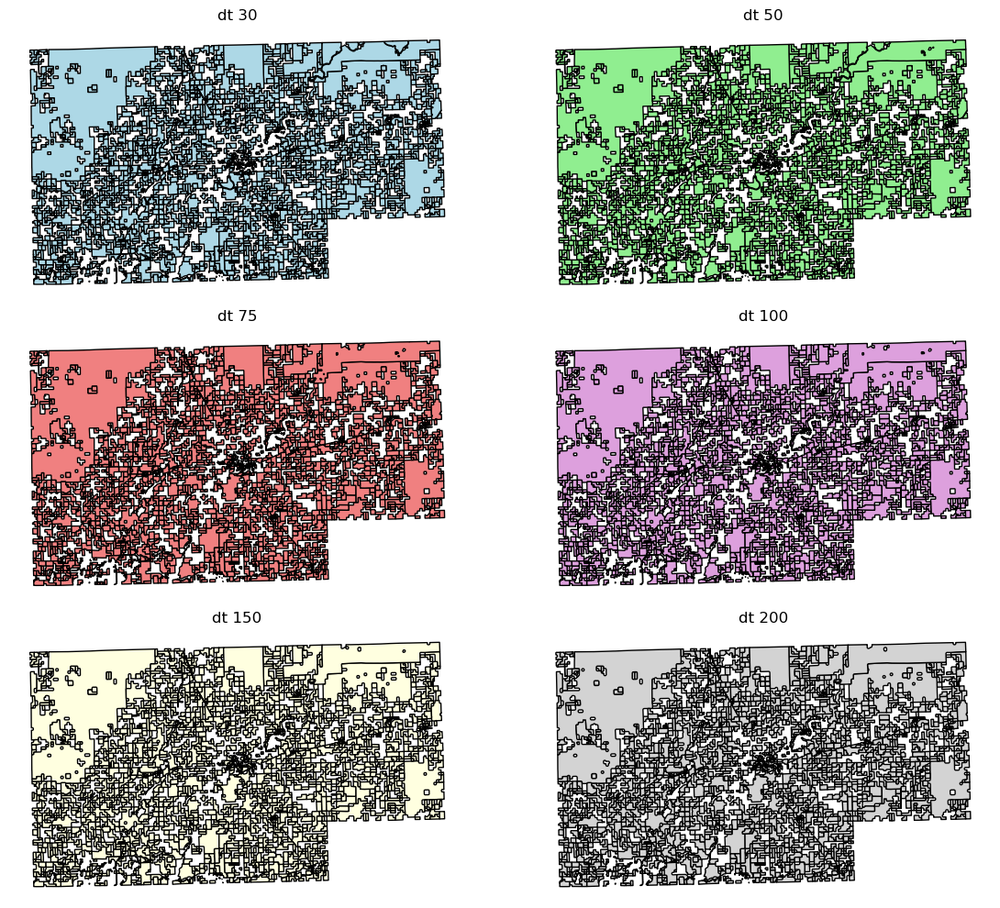

In [6]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(12, 10))

# Plot each GeoDataFrame in its corresponding subplot
gdf1.plot(ax=axes[0, 0], color='lightblue', edgecolor='black')
axes[0, 0].set_title('dt 30')

gdf2.plot(ax=axes[0, 1], color='lightgreen', edgecolor='black')
axes[0, 1].set_title('dt 50')

gdf3.plot(ax=axes[1, 0], color='lightcoral', edgecolor='black')
axes[1, 0].set_title('dt 75')

gdf4.plot(ax=axes[1, 1], color='plum', edgecolor='black')
axes[1, 1].set_title('dt 100')

gdf5.plot(ax=axes[2, 0], color='lightyellow', edgecolor='black')
axes[2, 0].set_title('dt 150')

gdf6.plot(ax=axes[2, 1], color='lightgrey', edgecolor='black')
axes[2, 1].set_title('dt 200')

# Optionally, remove axis ticks and labels for a cleaner look
for ax in axes.flatten():
    ax.set_axis_off()

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


In [7]:
utm_crs = gdf1.estimate_utm_crs().to_epsg()
gdf1 = gdf1.to_crs(epsg=utm_crs)
gdf2 = gdf2.to_crs(epsg=utm_crs)
gdf3 = gdf3.to_crs(epsg=utm_crs)
gdf4 = gdf4.to_crs(epsg=utm_crs)
gdf5 = gdf5.to_crs(epsg=utm_crs)
gdf6 = gdf6.to_crs(epsg=utm_crs)


In [8]:
for gdf in [gdf1, gdf2, gdf3, gdf4, gdf5, gdf6]:
    gdf['area'] = gdf.geometry.area

In [66]:

def compute_owner_stats(gdf, model_name):
    owner_stats = gdf.groupby('owner').agg({
        'pcount': 'sum',
        'area': 'sum'
    }).reset_index()
    owner_stats['model'] = model_name
    return owner_stats

stats_dt30 = compute_owner_stats(gdf1, 'dt 30')
stats_dt50 = compute_owner_stats(gdf2, 'dt 50')
stats_dt75 = compute_owner_stats(gdf3, 'dt 75')
stats_dt100 = compute_owner_stats(gdf4, 'dt 100')
stats_dt150 = compute_owner_stats(gdf5, 'dt 150')
stats_dt200 = compute_owner_stats(gdf6, 'dt 200')



In [67]:
combined_stats = pd.concat([stats_dt30, stats_dt50, stats_dt75, stats_dt100, stats_dt150, stats_dt200])


In [68]:
# Pivot for parcel counts
pivot_pcount = combined_stats.pivot(index='owner', columns='model', values='pcount')

# Pivot for areas
pivot_area = combined_stats.pivot(index='owner', columns='model', values='area')


In [69]:
# Calculate percentage change relative to Model 1 for parcel counts
pct_change_pcount = ((pivot_pcount.subtract(pivot_pcount['dt 200'], axis=0)
                      .divide(pivot_pcount['dt 200'], axis=0)) * 100)

# Calculate percentage change relative to dt 200 for area
pct_change_area = ((pivot_area.subtract(pivot_area['dt 200'], axis=0)
                    .divide(pivot_area['dt 200'], axis=0)) * 100)


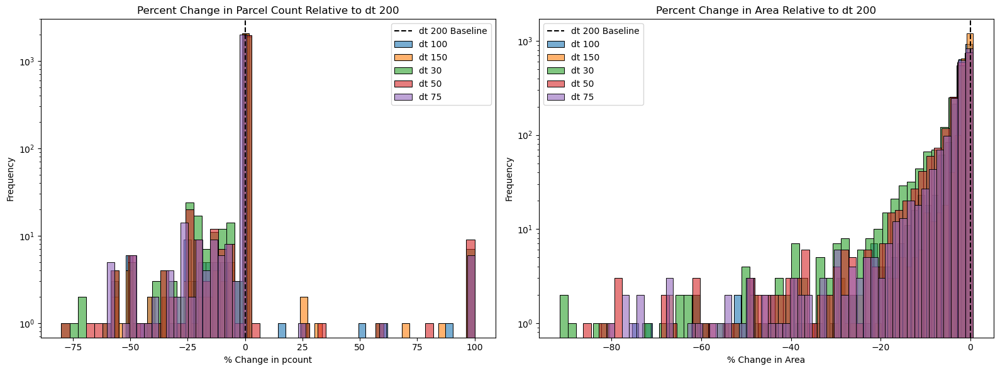

In [70]:
# Set up a grid layout: one subplot for parcel count changes, one for area changes.
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# For parcel count changes: plot the distribution for each model (excluding dt 200, which is the baseline)
for model in pct_change_pcount.columns:
    if model != 'dt 200':  # Only compare models against baseline.
        sns.histplot(pct_change_pcount[model].dropna(), bins=50, ax=axes[0], label=model, alpha=0.6)
# Add a vertical line at 0 which represents dt 200.
axes[0].axvline(0, color='black', linestyle='--', label='dt 200 Baseline')
axes[0].set_title('Percent Change in Parcel Count Relative to dt 200')
axes[0].set_xlabel('% Change in pcount')
axes[0].set_ylabel('Frequency')
axes[0].set_yscale('log')
axes[0].legend()

# For area changes: plot the distribution for each model (again, compared to baseline)
for model in pct_change_area.columns:
    if model != 'dt 200':
        sns.histplot(pct_change_area[model].dropna(), bins=50, ax=axes[1], label=model, alpha=0.6)
axes[1].axvline(0, color='black', linestyle='--', label='dt 200 Baseline')
axes[1].set_title('Percent Change in Area Relative to dt 200')
axes[1].set_xlabel('% Change in Area')
axes[1].set_ylabel('Frequency')
axes[1].set_yscale('log')
axes[1].legend()

plt.tight_layout()
plt.show()

In [71]:
def compare(base, compare, on='owner', suffixes=('_base', '_compare')):
    comparison = pd.merge(base, compare, on=on, suffixes=(suffixes[0], suffixes[1]))
    comparison['pcount_diff'] = comparison[f'pcount{suffixes[0]}'] - comparison[f'pcount{suffixes[1]}']
    comparison['area_diff'] = comparison[f'area{suffixes[0]}'] - comparison[f'area{suffixes[1]}']
    comparison['area_pct_change'] = (
        (comparison[f'area{suffixes[1]}'] - comparison[f'area{suffixes[0]}']) / comparison[f'area{suffixes[0]}']) * 100
    return comparison

# Compare each model to dt 200
compare_dt30 = compare(stats_dt200, stats_dt30, suffixes=('_dt200', '_dt30'))
compare_dt50 = compare(stats_dt200, stats_dt50, suffixes=('_dt200', '_dt50'))
compare_dt75 = compare(stats_dt200, stats_dt75, suffixes=('_dt200', '_dt75'))
compare_dt100 = compare(stats_dt200, stats_dt100, suffixes=('_dt200', '_dt100'))
compare_dt150 = compare(stats_dt200, stats_dt150, suffixes=('_dt200', '_dt150'))




In [73]:
compare_dt30['model'] = 'dt30'
compare_dt50['model'] = 'dt50'
compare_dt75['model'] = 'dt75'
compare_dt100['model'] = 'dt100'
compare_dt150['model'] = 'dt150'
combined = pd.concat([compare_dt30, compare_dt50, compare_dt75, compare_dt100, compare_dt150])


In [124]:
compare_dt30

,owner,pcount_dt200,area_dt200,model_dt200,pcount_dt30,area_dt30,model_dt30,pcount_diff,area_diff,area_pct_change,model
0,ADAMS DAWN M,5,4.101232e+05,dt 200,5,3.879226e+05,dt 30,0,22200.577816,-5.413149,dt30
1,ADAMS TROY G,6,8.408646e+05,dt 200,6,8.104730e+05,dt 30,0,30391.593117,-3.614326,dt30
2,ADERHOLD CRAIG,4,6.601077e+05,dt 200,4,6.601121e+05,dt 30,0,-4.416468,0.000669,dt30
3,ADKINS CLAIRE A,5,7.819501e+05,dt 200,5,7.732892e+05,dt 30,0,8660.954428,-1.107610,dt30
4,AGUILAR ALFREDO,9,1.271321e+06,dt 200,8,1.199473e+06,dt 30,1,71847.683156,-5.651420,dt30
...,...,...,...,...,...,...,...,...,...,...,...
2033,ZIMMER NOELLE,7,6.964298e+05,dt 200,7,5.300382e+05,dt 30,0,166391.694023,-23.892097,dt30
2034,ZIMMER PATRICK,4,2.969266e+04,dt 200,4,2.697622e+04,dt 30,0,2716.433050,-9.148502,dt30
2035,ZIMMER-PRASNICKY STACI L,12,7.113865e+03,dt 200,12,6.343890e+03,dt 30,0,769.975121,-10.823583,dt30
2036,ZMRAZEK STEVEN,3,4.889710e+05,dt 200,3,4.800715e+05,dt 30,0,8899.482565,-1.820043,dt30


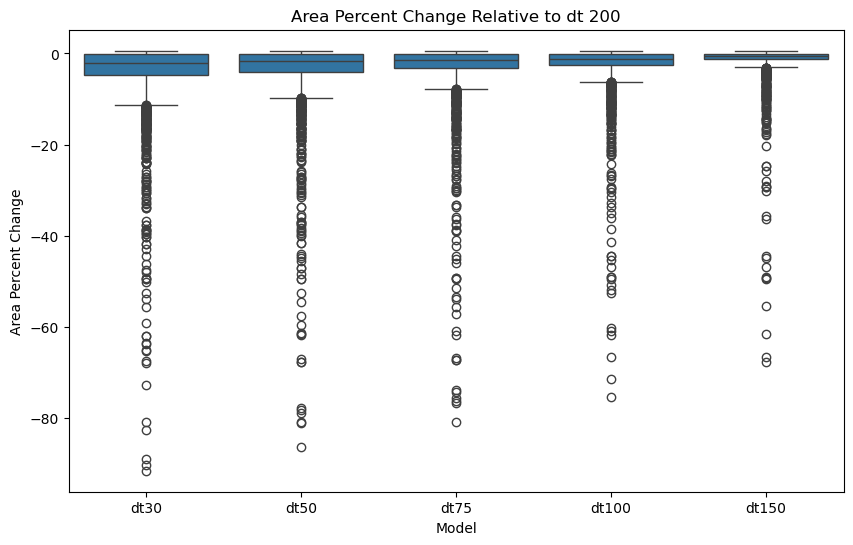

In [74]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=combined, x='model', y='area_pct_change')
plt.title('Area Percent Change Relative to dt 200')
plt.ylabel('Area Percent Change')
plt.xlabel('Model')
plt.show()


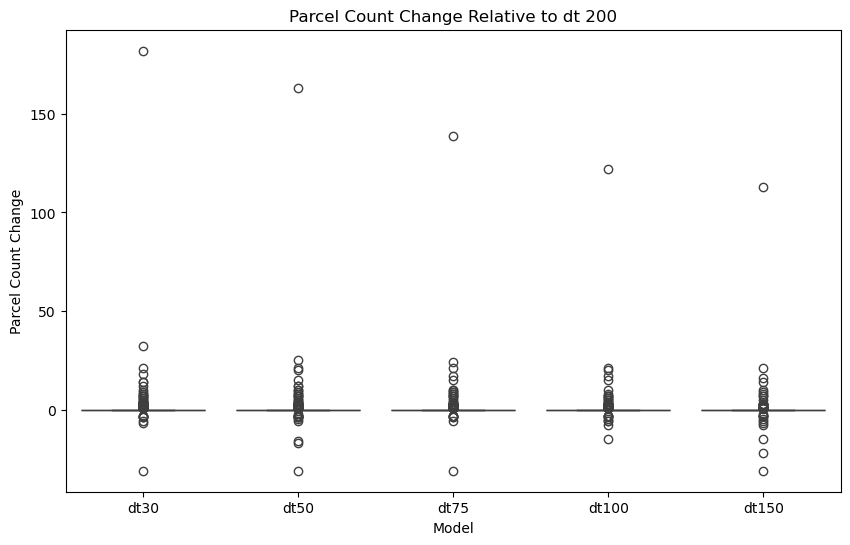

In [84]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=combined, x='model', y='pcount_diff')
plt.title('Parcel Count Change Relative to dt 200')
plt.ylabel('Parcel Count Change')
plt.xlabel('Model')
plt.show()


In [130]:
gdf1_merged = gdf1.merge(compare_dt30, on='owner')
gdf1_pcount_filter = gdf1_merged[(gdf1_merged['pcount_diff'] > 0)]

In [141]:


# Convert your GeoDataFrame to EPSG:4326 for interactive mapping
pcount_interactive = gdf1_pcount_filter.to_crs(epsg=4326)
gdf6_interactive = gdf6.to_crs(epsg=4326)

# Interactive map for parcel count difference
m_pcount = pcount_interactive.explore(
    column='pcount_diff',
    cmap='coolwarm',
    tooltip=['owner', 'pcount_diff'],
    legend=True,
    name='Parcel Count Diff'
)
# Define your HTML title string
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Parcel Count Difference (dt30 vs dt200)</b></h3>
             '''

# Add the title HTML to the map's root HTML
m_pcount.get_root().html.add_child(folium.Element(title_html))


# Similarly, create an interactive map for area percentage change
#m_area = gdf_interactive.explore(
#    column='area_pct_change',
#    cmap='coolwarm',
#    tooltip=['owner', 'area_pct_change'],
#    legend=True,
#    name='Area % Change'
#)

# Define a tooltip for the baseline layer using GeoJsonTooltip.
tooltip_baseline = folium.GeoJsonTooltip(
    fields=['owner', 'pcount'],
    aliases=['Owner:', 'Parcel Count (dt200):'],
    localize=True,
)

# Add the baseline as an interactive GeoJSON layer (with tooltips) to the m_pcount map.
folium.GeoJson(
    gdf6_interactive,
    name='Baseline dt200',
    tooltip=tooltip_baseline,
    style_function=lambda feature: {
        'fillOpacity': 0,        # transparent fill
        'color': '#555555',        # light black/gray outline
        'weight': 2,
    },
    interactive=True,  # Ensure the layer is interactive so tooltips work.
).add_to(m_pcount)

# Add the dt200 baseline to this map as well
folium_dt30 = folium.GeoJson(
    gdf1_merged,
    name='dt30',
    style_function=lambda feature: {
        'fillOpacity': 0.2,
        'color': '#6699CC', # grey
        'weight': 2
    },
    interactive=False
)

#folium_dt200.add_to(m_area)
#folium_dt30.add_to(m_area)
folium_dt30.add_to(m_pcount)
#folium.LayerControl().add_to(m_area)
folium.LayerControl().add_to(m_pcount)




In [142]:
m_pcount

In [121]:
m_area